## step1: EDA 
## step2: preprocessing
## step3: Feature engeenering
## step4: analysis of the features extracted
## step5: BOW 
## step6: Model Training

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import re
from bs4 import BeautifulSoup

import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv('input\train.csv')

In [21]:
new_df = df.sample(50000,random_state=2)

In [22]:
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate
398782,398782,496695,532029,What is the best marketing automation tool for...,What is the best marketing automation tool for...,1
115086,115086,187729,187730,I am poor but I want to invest. What should I do?,I am quite poor and I want to be very rich. Wh...,0
327711,327711,454161,454162,I am from India and live abroad. I met a guy f...,T.I.E.T to Thapar University to Thapar Univers...,0
367788,367788,498109,491396,Why do so many people in the U.S. hate the sou...,My boyfriend doesnt feel guilty when he hurts ...,0
151235,151235,237843,50930,Consequences of Bhopal gas tragedy?,What was the reason behind the Bhopal gas trag...,0


In [23]:
new_df.isnull().sum()

id              0
qid1            0
qid2            0
question1       0
question2       0
is_duplicate    0
dtype: int64

In [24]:
new_df.duplicated().sum()

np.int64(0)

# step1 : EDA

is_duplicate
0    31601
1    18399
Name: count, dtype: int64
is_duplicate
0    63.202
1    36.798
Name: count, dtype: float64


<Axes: xlabel='is_duplicate'>

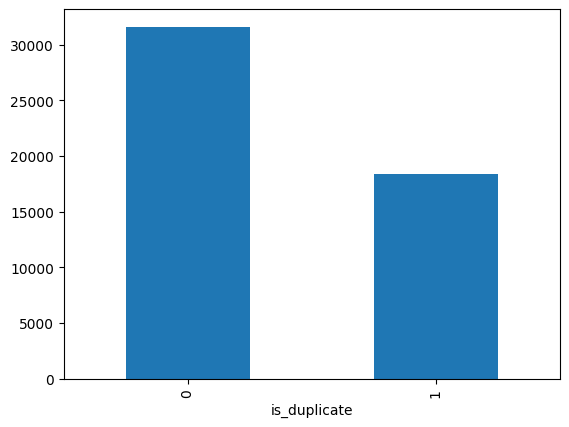

In [25]:
# Distribution of duplicate and non-duplicate questions

print(new_df['is_duplicate'].value_counts())
print((new_df['is_duplicate'].value_counts()/new_df['is_duplicate'].count())*100)
new_df['is_duplicate'].value_counts().plot(kind='bar')

In [26]:
# Repeated questions

qid = pd.Series(new_df['qid1'].tolist() + new_df['qid2'].tolist())
print('Number of unique questions',np.unique(qid).shape[0])
x = qid.value_counts()>1
print('Number of questions getting repeated',x[x].shape[0])

Number of unique questions 88945
Number of questions getting repeated 7384


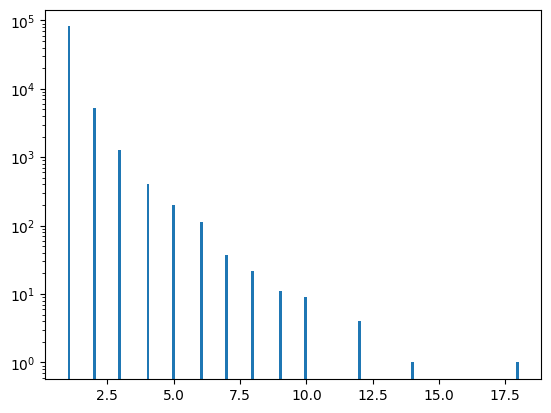

In [27]:
# Repeated questions histogram

plt.hist(qid.value_counts().values,bins=160)
plt.yscale('log')
plt.show()

# Step2: preprocessing

In [ ]:
import nltk
from nltk.stem import WordNetLemmatizer
from nltk import pos_tag #for part of speech
from nltk.corpus import wordnet
import os


# Set the NLTK data path to the directory where WordNet , stopwords and POStag are located
nltk.data.path.append('.venv\nltk_data\corpora\wordnet')
nltk.data.path.append('.venv\nltk_data\corpora\stopwords')
nltk.data.path.append('.venv\nltk_data\taggers\averaged_perceptron_tagger_eng')

In [29]:
from nltk.stem import WordNetLemmatizer
# Initialize the lemmatizer
lemmatizer = WordNetLemmatizer()

In [30]:
def get_wordnet_pos(treebank_tag):
    """Map NLTK's POS tags to WordNet's POS tags for lemmatizer."""
    if treebank_tag.startswith('J'):
        return wordnet.ADJ
    elif treebank_tag.startswith('V'):
        return wordnet.VERB
    elif treebank_tag.startswith('N'):
        return wordnet.NOUN
    elif treebank_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN  # Default to noun

In [31]:
def preprocess(q):
    
    q = str(q).lower().strip()
    
    # Replace certain special characters with their string equivalents
    q = q.replace('%', ' percent')
    q = q.replace('$', ' dollar ')
    q = q.replace('₹', ' rupee ')
    q = q.replace('€', ' euro ')
    q = q.replace('@', ' at ')
    
    # The pattern '[math]' appears around 900 times in the whole dataset.
    q = q.replace('[math]', '')
    
    # Replacing some numbers with string equivalents (not perfect, can be done better to account for more cases)
    q = q.replace(',000,000,000 ', 'b ')
    q = q.replace(',000,000 ', 'm ')
    q = q.replace(',000 ', 'k ')
    q = re.sub(r'([0-9]+)000000000', r'\1b', q)
    q = re.sub(r'([0-9]+)000000', r'\1m', q)
    q = re.sub(r'([0-9]+)000', r'\1k', q)
    
    # Decontracting words
    # https://en.wikipedia.org/wiki/Wikipedia%3aList_of_English_contractions
    # https://stackoverflow.com/a/19794953
    contractions = { 
    "ain't": "am not",
    "aren't": "are not",
    "can't": "can not",
    "can't've": "can not have",
    "'cause": "because",
    "could've": "could have",
    "couldn't": "could not",
    "couldn't've": "could not have",
    "didn't": "did not",
    "doesn't": "does not",
    "don't": "do not",
    "hadn't": "had not",
    "hadn't've": "had not have",
    "hasn't": "has not",
    "haven't": "have not",
    "he'd": "he would",
    "he'd've": "he would have",
    "he'll": "he will",
    "he'll've": "he will have",
    "he's": "he is",
    "how'd": "how did",
    "how'd'y": "how do you",
    "how'll": "how will",
    "how's": "how is",
    "i'd": "i would",
    "i'd've": "i would have",
    "i'll": "i will",
    "i'll've": "i will have",
    "i'm": "i am",
    "i've": "i have",
    "isn't": "is not",
    "it'd": "it would",
    "it'd've": "it would have",
    "it'll": "it will",
    "it'll've": "it will have",
    "it's": "it is",
    "let's": "let us",
    "ma'am": "madam",
    "mayn't": "may not",
    "might've": "might have",
    "mightn't": "might not",
    "mightn't've": "might not have",
    "must've": "must have",
    "mustn't": "must not",
    "mustn't've": "must not have",
    "needn't": "need not",
    "needn't've": "need not have",
    "o'clock": "of the clock",
    "oughtn't": "ought not",
    "oughtn't've": "ought not have",
    "shan't": "shall not",
    "sha'n't": "shall not",
    "shan't've": "shall not have",
    "she'd": "she would",
    "she'd've": "she would have",
    "she'll": "she will",
    "she'll've": "she will have",
    "she's": "she is",
    "should've": "should have",
    "shouldn't": "should not",
    "shouldn't've": "should not have",
    "so've": "so have",
    "so's": "so as",
    "that'd": "that would",
    "that'd've": "that would have",
    "that's": "that is",
    "there'd": "there would",
    "there'd've": "there would have",
    "there's": "there is",
    "they'd": "they would",
    "they'd've": "they would have",
    "they'll": "they will",
    "they'll've": "they will have",
    "they're": "they are",
    "they've": "they have",
    "to've": "to have",
    "wasn't": "was not",
    "we'd": "we would",
    "we'd've": "we would have",
    "we'll": "we will",
    "we'll've": "we will have",
    "we're": "we are",
    "we've": "we have",
    "weren't": "were not",
    "what'll": "what will",
    "what'll've": "what will have",
    "what're": "what are",
    "what's": "what is",
    "what've": "what have",
    "when's": "when is",
    "when've": "when have",
    "where'd": "where did",
    "where's": "where is",
    "where've": "where have",
    "who'll": "who will",
    "who'll've": "who will have",
    "who's": "who is",
    "who've": "who have",
    "why's": "why is",
    "why've": "why have",
    "will've": "will have",
    "won't": "will not",
    "won't've": "will not have",
    "would've": "would have",
    "wouldn't": "would not",
    "wouldn't've": "would not have",
    "y'all": "you all",
    "y'all'd": "you all would",
    "y'all'd've": "you all would have",
    "y'all're": "you all are",
    "y'all've": "you all have",
    "you'd": "you would",
    "you'd've": "you would have",
    "you'll": "you will",
    "you'll've": "you will have",
    "you're": "you are",
    "you've": "you have"
    }

    q_decontracted = []

    for word in q.split():
        if word in contractions:
            word = contractions[word]

        q_decontracted.append(word)

    q = ' '.join(q_decontracted)
    q = q.replace("'ve", " have")
    q = q.replace("n't", " not")
    q = q.replace("'re", " are")
    q = q.replace("'ll", " will")
    
    # Removing HTML tags
    q = BeautifulSoup(q)
    q = q.get_text()
    
    # Remove punctuations
    pattern = re.compile('\W')
    q = re.sub(pattern, ' ', q).strip()

    # Lemmatization
    pos_tagged = pos_tag(q.split())
    print(pos_tagged)
    q = ' '.join([lemmatizer.lemmatize(word, get_wordnet_pos(tag)) for word, tag in pos_tagged])
    
    
    return q
    

In [32]:
preprocess("I've already! wasn't <b>done</b> , I will running  ?")

[('i', 'NNS'), ('have', 'VBP'), ('already', 'RB'), ('was', 'VBD'), ('not', 'RB'), ('done', 'VBN'), ('i', 'NN'), ('will', 'MD'), ('running', 'VB')]


'i have already be not do i will run'

In [33]:
new_df['question1'] = new_df['question1'].apply(preprocess)
new_df['question2'] = new_df['question2'].apply(preprocess)

[('what', 'WP'), ('is', 'VBZ'), ('the', 'DT'), ('best', 'JJS'), ('marketing', 'NN'), ('automation', 'NN'), ('tool', 'NN'), ('for', 'IN'), ('small', 'JJ'), ('and', 'CC'), ('mid', 'JJ'), ('size', 'NN'), ('companies', 'NNS')]
[('i', 'NN'), ('am', 'VBP'), ('poor', 'JJ'), ('but', 'CC'), ('i', 'JJ'), ('want', 'VBP'), ('to', 'TO'), ('invest', 'VB'), ('what', 'WP'), ('should', 'MD'), ('i', 'VB'), ('do', 'VB')]
[('i', 'NN'), ('am', 'VBP'), ('from', 'IN'), ('india', 'NN'), ('and', 'CC'), ('live', 'JJ'), ('abroad', 'RB'), ('i', 'JJ'), ('met', 'VBD'), ('a', 'DT'), ('guy', 'NN'), ('from', 'IN'), ('france', 'NN'), ('in', 'IN'), ('a', 'DT'), ('party', 'NN'), ('i', 'NN'), ('want', 'VBP'), ('to', 'TO'), ('date', 'NN'), ('him', 'PRP'), ('how', 'WRB'), ('do', 'VB'), ('i', 'VB'), ('do', 'VB'), ('that', 'DT')]
[('why', 'WRB'), ('do', 'VBP'), ('so', 'RB'), ('many', 'JJ'), ('people', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('u', 'JJ'), ('s', 'NN'), ('hate', 'VBP'), ('the', 'DT'), ('southern', 'JJ'), ('states', 

In [34]:
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate
398782,398782,496695,532029,what be the best marketing automation tool for...,what be the best marketing automation tool for...,1
115086,115086,187729,187730,i be poor but i want to invest what should i do,i be quite poor and i want to be very rich wha...,0
327711,327711,454161,454162,i be from india and live abroad i meet a guy f...,t i e t to thapar university to thapar univers...,0
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0
151235,151235,237843,50930,consequence of bhopal gas tragedy,what be the reason behind the bhopal gas tragedy,0


# step3: Feature engeneering

In [35]:
# Feature Engineering

new_df['q1_len'] = new_df['question1'].str.len() 
new_df['q2_len'] = new_df['question2'].str.len()

In [36]:
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len
398782,398782,496695,532029,what be the best marketing automation tool for...,what be the best marketing automation tool for...,1,73,74
115086,115086,187729,187730,i be poor but i want to invest what should i do,i be quite poor and i want to be very rich wha...,0,47,55
327711,327711,454161,454162,i be from india and live abroad i meet a guy f...,t i e t to thapar university to thapar univers...,0,103,118
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,133
151235,151235,237843,50930,consequence of bhopal gas tragedy,what be the reason behind the bhopal gas tragedy,0,33,48


In [37]:
new_df['q1_num_words'] = new_df['question1'].apply(lambda row: len(row.split(" ")))
new_df['q2_num_words'] = new_df['question2'].apply(lambda row: len(row.split(" ")))
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words
398782,398782,496695,532029,what be the best marketing automation tool for...,what be the best marketing automation tool for...,1,73,74,13,13
115086,115086,187729,187730,i be poor but i want to invest what should i do,i be quite poor and i want to be very rich wha...,0,47,55,12,15
327711,327711,454161,454162,i be from india and live abroad i meet a guy f...,t i e t to thapar university to thapar univers...,0,103,118,26,20
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,133,13,30
151235,151235,237843,50930,consequence of bhopal gas tragedy,what be the reason behind the bhopal gas tragedy,0,33,48,5,9


In [38]:
def common_words(row):
    w1 = set(map(lambda word: word.lower().strip(), row['question1'].split(" ")))
    w2 = set(map(lambda word: word.lower().strip(), row['question2'].split(" "))) 
    return len(w1 & w2)

In [39]:
new_df['word_common'] = new_df.apply(common_words, axis=1)
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,word_common
398782,398782,496695,532029,what be the best marketing automation tool for...,what be the best marketing automation tool for...,1,73,74,13,13,12
115086,115086,187729,187730,i be poor but i want to invest what should i do,i be quite poor and i want to be very rich wha...,0,47,55,12,15,7
327711,327711,454161,454162,i be from india and live abroad i meet a guy f...,t i e t to thapar university to thapar univers...,0,103,118,26,20,3
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,133,13,30,0
151235,151235,237843,50930,consequence of bhopal gas tragedy,what be the reason behind the bhopal gas tragedy,0,33,48,5,9,3


In [40]:
def total_words(row):
    w1 = set(map(lambda word: word.lower().strip(), row['question1'].split(" ")))
    w2 = set(map(lambda word: word.lower().strip(), row['question2'].split(" ")))    
    return (len(w1) + len(w2))

In [41]:
new_df['word_total'] = new_df.apply(total_words, axis=1)
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,word_common,word_total
398782,398782,496695,532029,what be the best marketing automation tool for...,what be the best marketing automation tool for...,1,73,74,13,13,12,26
115086,115086,187729,187730,i be poor but i want to invest what should i do,i be quite poor and i want to be very rich wha...,0,47,55,12,15,7,21
327711,327711,454161,454162,i be from india and live abroad i meet a guy f...,t i e t to thapar university to thapar univers...,0,103,118,26,20,3,36
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,133,13,30,0,31
151235,151235,237843,50930,consequence of bhopal gas tragedy,what be the reason behind the bhopal gas tragedy,0,33,48,5,9,3,13


In [42]:
new_df['word_share'] = round(new_df['word_common']/new_df['word_total'],2)
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,word_common,word_total,word_share
398782,398782,496695,532029,what be the best marketing automation tool for...,what be the best marketing automation tool for...,1,73,74,13,13,12,26,0.46
115086,115086,187729,187730,i be poor but i want to invest what should i do,i be quite poor and i want to be very rich wha...,0,47,55,12,15,7,21,0.33
327711,327711,454161,454162,i be from india and live abroad i meet a guy f...,t i e t to thapar university to thapar univers...,0,103,118,26,20,3,36,0.08
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,133,13,30,0,31,0.00
151235,151235,237843,50930,consequence of bhopal gas tragedy,what be the reason behind the bhopal gas tragedy,0,33,48,5,9,3,13,0.23


# step 3.1 : extract Advanced features

## Advanced Features

### 1. Token Features
- *cwc_min*: This is the ratio of the number of common words to the length of the smaller question
- *cwc_max*: This is the ratio of the number of common words to the length of the larger question
- *csc_min*: This is the ratio of the number of common stop words to the smaller stop word count among the two questions
- *csc_max*: This is the ratio of the number of common stop words to the larger stop word count among the two questions
- *ctc_min*: This is the ratio of the number of common tokens to the smaller token count among the two questions
- *ctc_max*: This is the ratio of the number of common tokens to the larger token count among the two questions
- *last_word_eq*: 1 if the last word in the two questions is same, 0 otherwise
- *first_word_eq*: 1 if the first word in the two questions is same, 0 otherwise

### 2. Length Based Features
- *mean_len*: Mean of the length of the two questions (number of words)
- *abs_len_diff*: Absolute difference between the length of the two questions (number of words)
- *longest_substr_ratio*: Ratio of the length of the longest substring among the two questions to the length of the smaller question

### 3. Fuzzy Features
- *fuzz_ratio*: fuzz_ratio score from fuzzywuzzy: Compares the entire strings directly and calculates a similarity ratio.
- *fuzz_partial_ratio*: fuzz_partial_ratio from fuzzywuzzy: Compares substrings of the shorter string against the longer string to find the best partial match.
- *token_sort_ratio*: token_sort_ratio from fuzzywuzzy: Tokenizes the strings, sorts the tokens alphabetically, and then compares them.
- *token_set_ratio*: token_set_ratio from fuzzywuzzy: Tokenizes the strings, removes duplicate tokens, and compares them. Additionally, it accounts for tokens being subsets of each other.

In [43]:
#Example: 
#  question1  -> Total word count = 20, Stop word count = 6, non stop word count = 14, total token count = 19
# question2  -> Total word count = 30, Stop word count = 3, non stop word count = 27, token token count = 30

# common stop word count = 2
# common non-stop word count = 10
# common token word count = 12

# cwc_min = 10/20
# cwc_max = 10/30
# csc_min = 2/3
# csc_max = 2/6
# ctc_min = 12/19
# ctc_max = 12/30
# mean_len = 20+30/2 = 25
# abs_len_diff = abs(20 - 30) = 10
# longest_substr_ratio = 3/7

# q1 = who is the president of your country? n^2 = 7^2 = 49
# q2 =  what is the national sport of your country?
# fuzz_ratio = 15
# fuzz_partial_ratio = 35
#

In [44]:
# Advanced Features
from nltk.corpus import stopwords

def fetch_token_features(row):
    
    q1 = row['question1']
    q2 = row['question2']
    
    SAFE_DIV = 0.0001 

    STOP_WORDS = stopwords.words("english")
    
    token_features = [0.0]*8
    
    # Converting the Sentence into Tokens: 
    q1_tokens = q1.split()
    q2_tokens = q2.split()
    
    if len(q1_tokens) == 0 or len(q2_tokens) == 0:
        return token_features

    # Get the non-stopwords in Questions
    q1_words = set([word for word in q1_tokens if word not in STOP_WORDS])
    q2_words = set([word for word in q2_tokens if word not in STOP_WORDS])
    
    #Get the stopwords in Questions
    q1_stops = set([word for word in q1_tokens if word in STOP_WORDS])
    q2_stops = set([word for word in q2_tokens if word in STOP_WORDS])
    
    # Get the common non-stopwords from Question pair
    common_word_count = len(q1_words.intersection(q2_words))
    
    # Get the common stopwords from Question pair
    common_stop_count = len(q1_stops.intersection(q2_stops))
    
    # Get the common Tokens from Question pair
    common_token_count = len(set(q1_tokens).intersection(set(q2_tokens)))
    
    
    token_features[0] = common_word_count / (min(len(q1_words), len(q2_words)) + SAFE_DIV)
    token_features[1] = common_word_count / (max(len(q1_words), len(q2_words)) + SAFE_DIV)
    token_features[2] = common_stop_count / (min(len(q1_stops), len(q2_stops)) + SAFE_DIV)
    token_features[3] = common_stop_count / (max(len(q1_stops), len(q2_stops)) + SAFE_DIV)
    token_features[4] = common_token_count / (min(len(q1_tokens), len(q2_tokens)) + SAFE_DIV)
    token_features[5] = common_token_count / (max(len(q1_tokens), len(q2_tokens)) + SAFE_DIV)
    
    # Last word of both question is same or not
    token_features[6] = int(q1_tokens[-1] == q2_tokens[-1])
    
    # First word of both question is same or not
    token_features[7] = int(q1_tokens[0] == q2_tokens[0])
    
    return token_features

In [45]:
token_features = new_df.apply(fetch_token_features, axis=1) #return list of dim 50000 x 8
print(token_features)
print(token_features.shape)

398782    [0.874989062636717, 0.874989062636717, 0.99998...
115086    [0.6666444451851604, 0.49998750031249223, 0.71...
327711    [0.0, 0.0, 0.4285653062099113, 0.2727247934109...
367788                 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0, 0]
151235    [0.7499812504687383, 0.5999880002399952, 0.0, ...
                                ...                        
362916    [0.3333222225925802, 0.24999375015624611, 0.99...
292183    [0.7499812504687383, 0.5999880002399952, 0.333...
360529    [0.6666444451851604, 0.6666444451851604, 0.999...
327759    [0.5999880002399952, 0.4285653062099113, 0.799...
226665    [0.6666444451851604, 0.49998750031249223, 0.39...
Length: 50000, dtype: object
(50000,)


In [28]:
#fetch token features
token_features = new_df.apply(fetch_token_features, axis=1)

new_df["cwc_min"]       = list(map(lambda x: x[0], token_features))
new_df["cwc_max"]       = list(map(lambda x: x[1], token_features))
new_df["csc_min"]       = list(map(lambda x: x[2], token_features))
new_df["csc_max"]       = list(map(lambda x: x[3], token_features))
new_df["ctc_min"]       = list(map(lambda x: x[4], token_features))
new_df["ctc_max"]       = list(map(lambda x: x[5], token_features))
new_df["last_word_eq"]  = list(map(lambda x: x[6], token_features))
new_df["first_word_eq"] = list(map(lambda x: x[7], token_features))

In [29]:
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,...,word_total,word_share,cwc_min,cwc_max,csc_min,csc_max,ctc_min,ctc_max,last_word_eq,first_word_eq
398782,398782,496695,532029,what is the best marketing automation tool for...,what is the best marketing automation tool for...,1,73,74,13,13,...,26,0.46,0.874989,0.874989,0.999980,0.999980,0.923070,0.923070,1.0,1.0
115086,115086,187729,187730,i am poor but i want to invest what should i do,i am quite poor and i want to be very rich wha...,0,47,55,12,15,...,22,0.32,0.666644,0.499988,0.714276,0.624992,0.583328,0.466664,1.0,1.0
327711,327711,454161,454162,i am from india and live abroad i met a guy fr...,t i e t to thapar university to thapar univers...,0,102,118,26,20,...,36,0.08,0.000000,0.000000,0.428565,0.272725,0.149999,0.115384,0.0,0.0
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,140,13,30,...,32,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0
151235,151235,237843,50930,consequence of bhopal gas tragedy,what wa the reason behind the bhopal gas tragedy,0,33,48,5,9,...,13,0.23,0.749981,0.499992,0.000000,0.000000,0.599988,0.333330,1.0,0.0


In [30]:
import distance


def fetch_length_features(row):
    SAFE_DIV = 0.0001 
    
    q1 = row['question1']
    q2 = row['question2']
    
    length_features = [0.0]*3
    
    # Converting the Sentence into Tokens: 
    q1_tokens = q1.split()
    q2_tokens = q2.split()
    
    if len(q1_tokens) == 0 or len(q2_tokens) == 0:
        return length_features
    
    # Absolute length features
    length_features[0] = abs(len(q1_tokens) - len(q2_tokens))
    
    #Average Token Length of both Questions
    length_features[1] = (len(q1_tokens) + len(q2_tokens))/2
    
    strs = list(distance.lcsubstrings(q1, q2))
    length_features[2] = len(strs[0]) / (min(len(q1), len(q2)) + SAFE_DIV)
    
    return length_features

In [31]:
length_features = new_df.apply(fetch_length_features, axis=1)

new_df['abs_len_diff'] = list(map(lambda x: x[0], length_features))
new_df['mean_len'] = list(map(lambda x: x[1], length_features))
new_df['longest_substr_ratio'] = list(map(lambda x: x[2], length_features))

In [32]:
new_df.head()

,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,...,cwc_max,csc_min,csc_max,ctc_min,ctc_max,last_word_eq,first_word_eq,abs_len_diff,mean_len,longest_substr_ratio
398782,398782,496695,532029,what is the best marketing automation tool for...,what is the best marketing automation tool for...,1,73,74,13,13,...,0.874989,0.999980,0.999980,0.923070,0.923070,1.0,1.0,0.0,13.0,0.890410
115086,115086,187729,187730,i am poor but i want to invest what should i do,i am quite poor and i want to be very rich wha...,0,47,55,12,15,...,0.499988,0.714276,0.624992,0.583328,0.466664,1.0,1.0,3.0,13.5,0.234042
327711,327711,454161,454162,i am from india and live abroad i met a guy fr...,t i e t to thapar university to thapar univers...,0,102,118,26,20,...,0.000000,0.428565,0.272725,0.149999,0.115384,0.0,0.0,6.0,23.0,0.049020
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,140,13,30,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,17.0,21.5,0.053571
151235,151235,237843,50930,consequence of bhopal gas tragedy,what wa the reason behind the bhopal gas tragedy,0,33,48,5,9,...,0.499992,0.000000,0.000000,0.599988,0.333330,1.0,0.0,4.0,7.0,0.575756


In [33]:
# Fuzzy Features
from fuzzywuzzy import fuzz

def fetch_fuzzy_features(row):
    
    q1 = row['question1']
    q2 = row['question2']
    
    fuzzy_features = [0.0]*4
    
    # fuzz_ratio
    fuzzy_features[0] = fuzz.QRatio(q1, q2)

    # fuzz_partial_ratio
    fuzzy_features[1] = fuzz.partial_ratio(q1, q2)

    # token_sort_ratio
    fuzzy_features[2] = fuzz.token_sort_ratio(q1, q2)

    # token_set_ratio
    fuzzy_features[3] = fuzz.token_set_ratio(q1, q2)

    return fuzzy_features

In [34]:
# examle fuzzy function
fuzz.QRatio('Python', 'Learn Python')

67

In [35]:
fuzz.partial_ratio('Python', 'Learn Python')

100

In [36]:
fuzz.QRatio('python programming', 'programming python')

61

In [37]:
fuzz.token_sort_ratio('python programming', 'programming python')

100

In [38]:
fuzz.QRatio('learn python programming', 'learn python')

67

In [39]:
fuzz.token_set_ratio('learn python programming', 'python learn')

100

In [40]:
fuzzy_features = new_df.apply(fetch_fuzzy_features, axis=1)

# Creating new feature columns for fuzzy features
new_df['fuzz_ratio'] = list(map(lambda x: x[0], fuzzy_features))
new_df['fuzz_partial_ratio'] = list(map(lambda x: x[1], fuzzy_features))
new_df['token_sort_ratio'] = list(map(lambda x: x[2], fuzzy_features))
new_df['token_set_ratio'] = list(map(lambda x: x[3], fuzzy_features))

In [41]:
print(new_df.shape)
new_df.head()

(50000, 28)


,id,qid1,qid2,question1,question2,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,...,ctc_max,last_word_eq,first_word_eq,abs_len_diff,mean_len,longest_substr_ratio,fuzz_ratio,fuzz_partial_ratio,token_sort_ratio,token_set_ratio
398782,398782,496695,532029,what is the best marketing automation tool for...,what is the best marketing automation tool for...,1,73,74,13,13,...,0.923070,1.0,1.0,0.0,13.0,0.890410,99,99,99,99
115086,115086,187729,187730,i am poor but i want to invest what should i do,i am quite poor and i want to be very rich wha...,0,47,55,12,15,...,0.466664,1.0,1.0,3.0,13.5,0.234042,69,66,65,74
327711,327711,454161,454162,i am from india and live abroad i met a guy fr...,t i e t to thapar university to thapar univers...,0,102,118,26,20,...,0.115384,0.0,0.0,6.0,23.0,0.049020,26,30,34,43
367788,367788,498109,491396,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...,0,56,140,13,30,...,0.000000,0.0,0.0,17.0,21.5,0.053571,26,45,26,30
151235,151235,237843,50930,consequence of bhopal gas tragedy,what wa the reason behind the bhopal gas tragedy,0,33,48,5,9,...,0.333330,1.0,0.0,4.0,7.0,0.575756,57,71,49,71


# step4: analysis of the features extracted

minimum characters 1
maximum characters 383
average num of characters 57


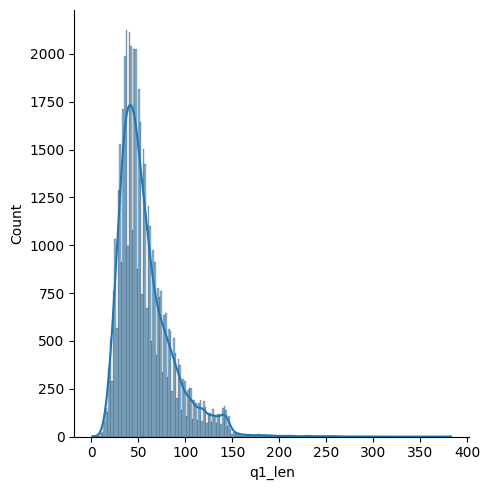

In [42]:
# Analysis of features
sns.displot(new_df['q1_len'], kde=True)
print('minimum characters',new_df['q1_len'].min())
print('maximum characters',new_df['q1_len'].max())
print('average num of characters',int(new_df['q1_len'].mean()))

minimum characters 0
maximum characters 1129
average num of characters 57


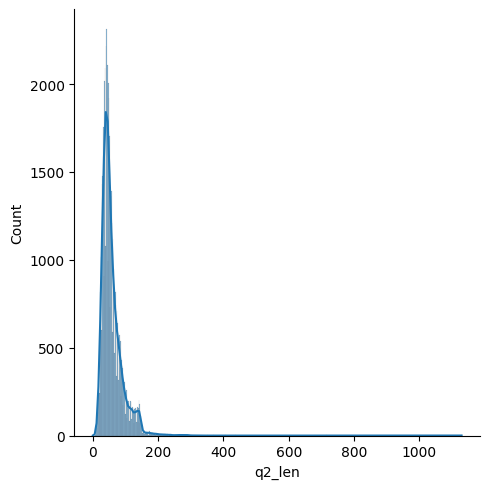

In [43]:
sns.displot(new_df['q2_len'], kde=True)
print('minimum characters',new_df['q2_len'].min())
print('maximum characters',new_df['q2_len'].max())
print('average num of characters',int(new_df['q2_len'].mean()))

minimum words 1
maximum words 73
average num of words 11


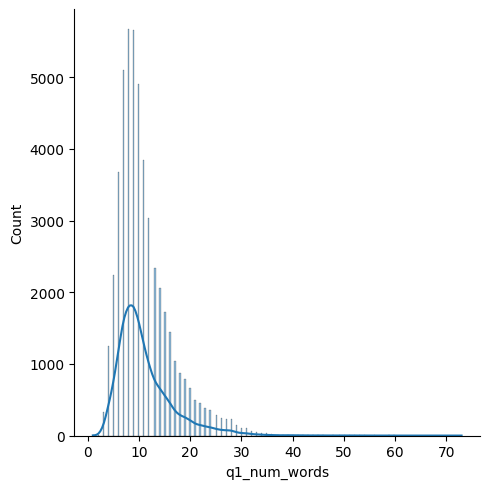

In [44]:
sns.displot(new_df['q1_num_words'], kde=True)
print('minimum words',new_df['q1_num_words'].min())
print('maximum words',new_df['q1_num_words'].max())
print('average num of words',int(new_df['q1_num_words'].mean()))

minimum words 1
maximum words 248
average num of words 11


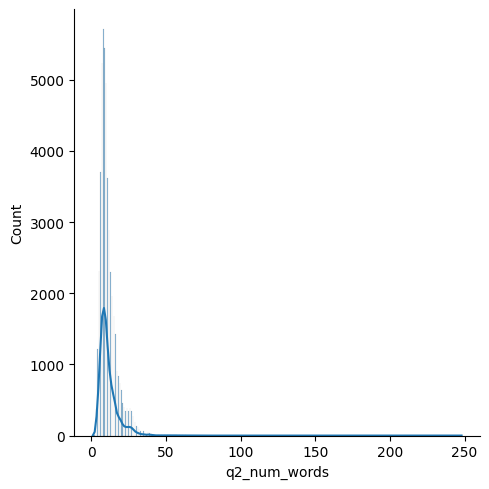

In [45]:
sns.displot(new_df['q2_num_words'], kde=True)
print('minimum words',new_df['q2_num_words'].min())
print('maximum words',new_df['q2_num_words'].max())
print('average num of words',int(new_df['q2_num_words'].mean()))

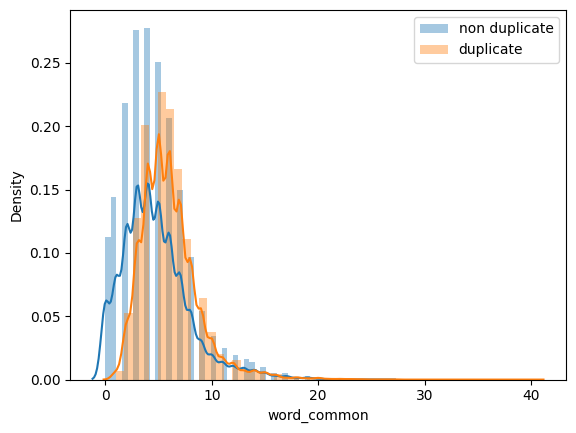

In [46]:
# common words
sns.distplot(new_df[new_df['is_duplicate'] == 0]['word_common'],label='non duplicate')
sns.distplot(new_df[new_df['is_duplicate'] == 1]['word_common'],label='duplicate')
plt.legend()
plt.show()

<Axes: xlabel='word_common', ylabel='Density'>

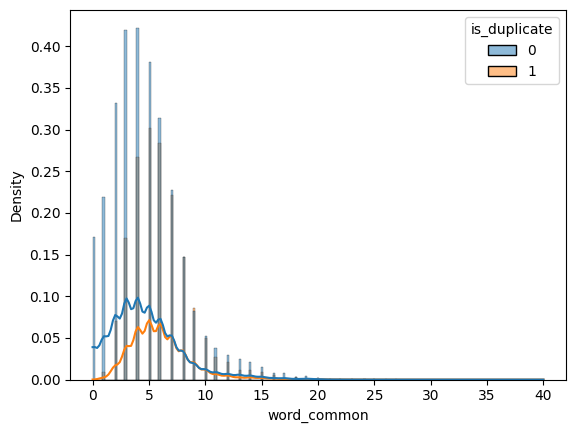

In [47]:
sns.histplot(data=new_df, x='word_common', hue='is_duplicate', stat='density', kde=True)

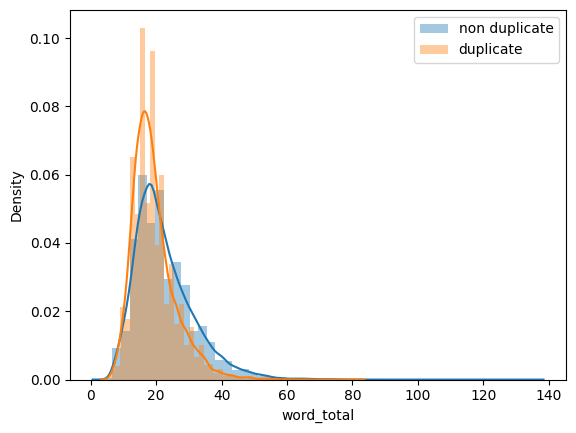

In [48]:
# total words
sns.distplot(new_df[new_df['is_duplicate'] == 0]['word_total'],label='non duplicate')
sns.distplot(new_df[new_df['is_duplicate'] == 1]['word_total'],label='duplicate')
plt.legend()
plt.show()

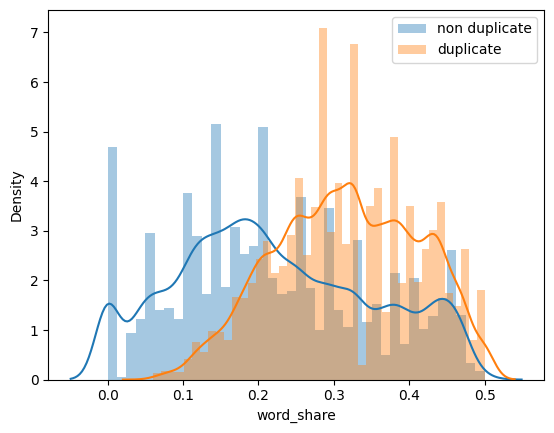

In [49]:
# word share
sns.distplot(new_df[new_df['is_duplicate'] == 0]['word_share'],label='non duplicate')
sns.distplot(new_df[new_df['is_duplicate'] == 1]['word_share'],label='duplicate')
plt.legend()
plt.show()

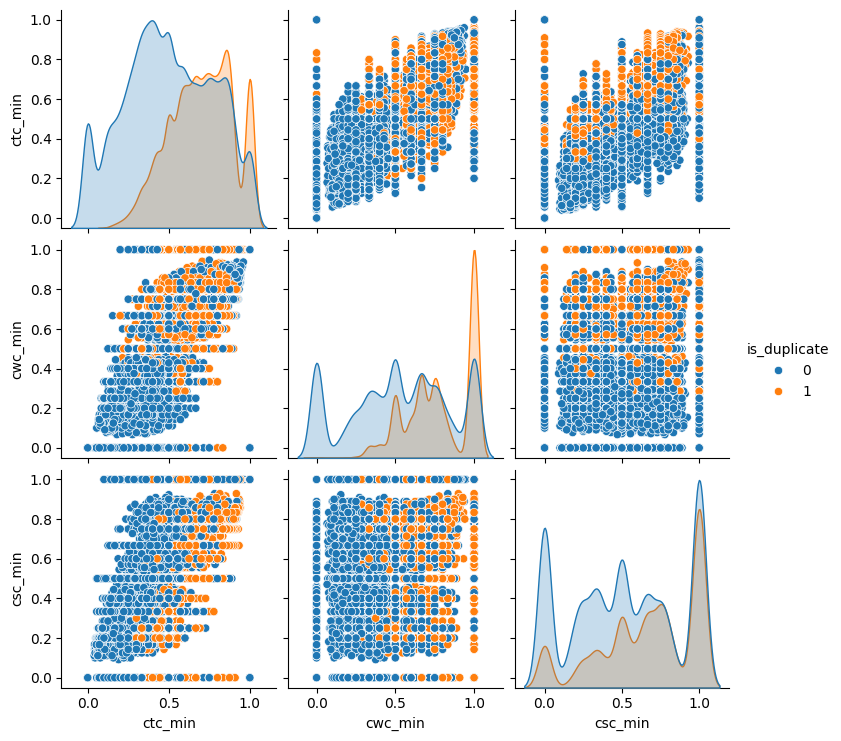

In [50]:
sns.pairplot(new_df[['ctc_min', 'cwc_min', 'csc_min', 'is_duplicate']],hue='is_duplicate')

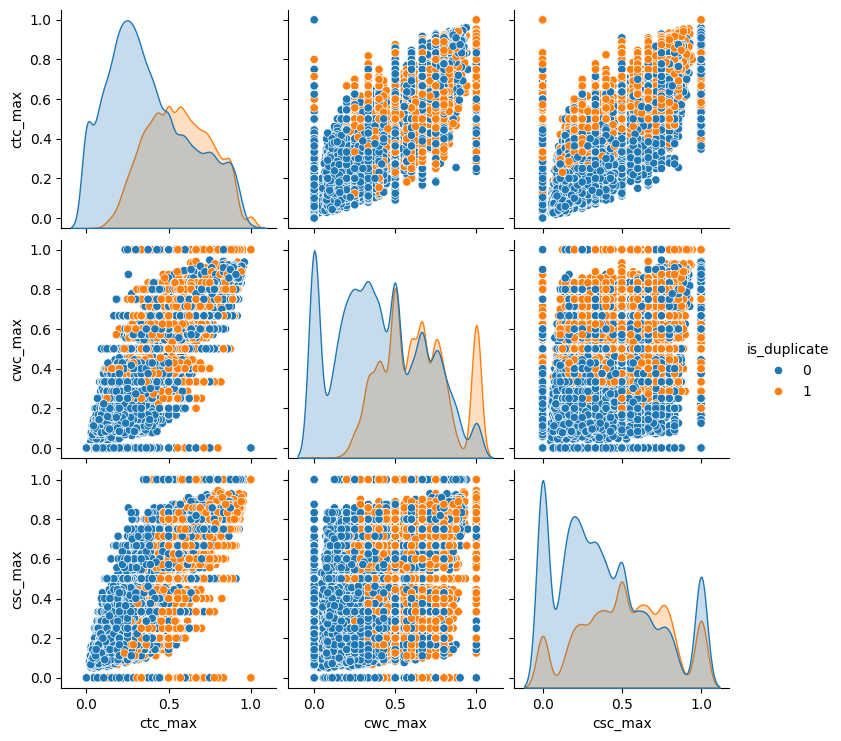

In [51]:
sns.pairplot(new_df[['ctc_max', 'cwc_max', 'csc_max', 'is_duplicate']],hue='is_duplicate')

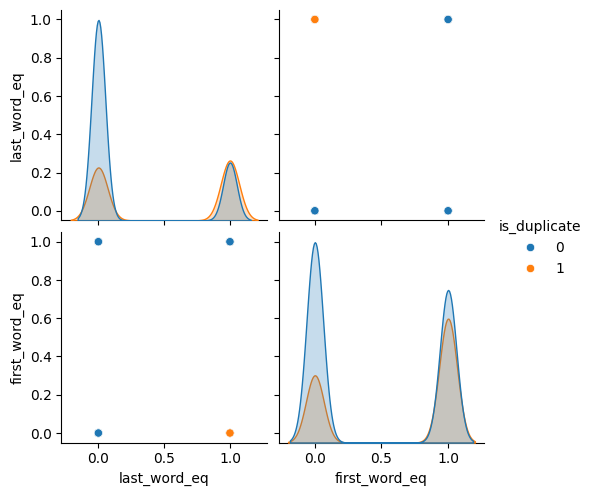

In [52]:
sns.pairplot(new_df[['last_word_eq', 'first_word_eq', 'is_duplicate']],hue='is_duplicate')

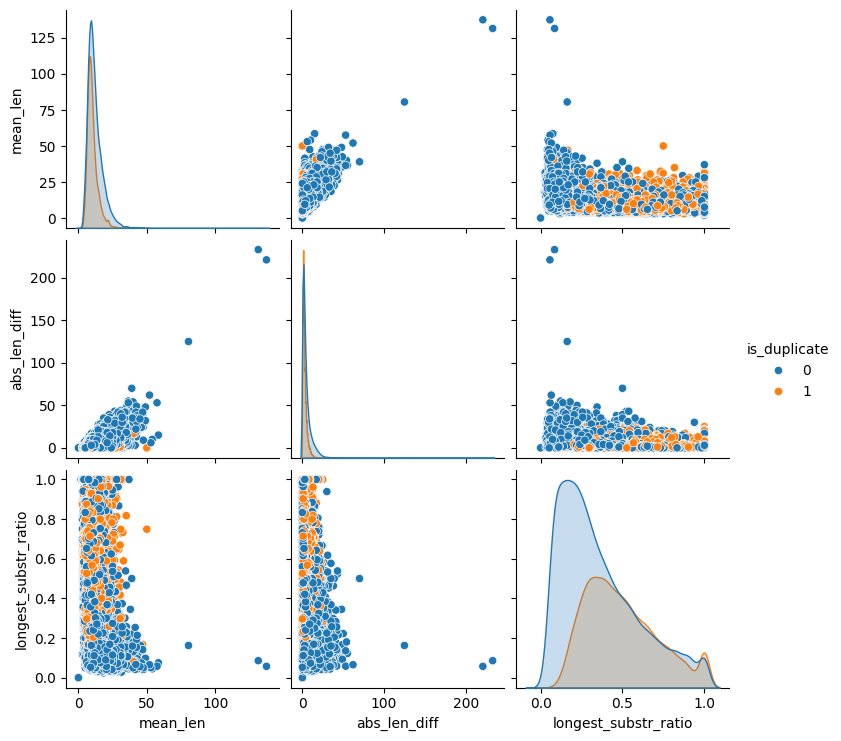

In [53]:
sns.pairplot(new_df[['mean_len', 'abs_len_diff','longest_substr_ratio', 'is_duplicate']],hue='is_duplicate')

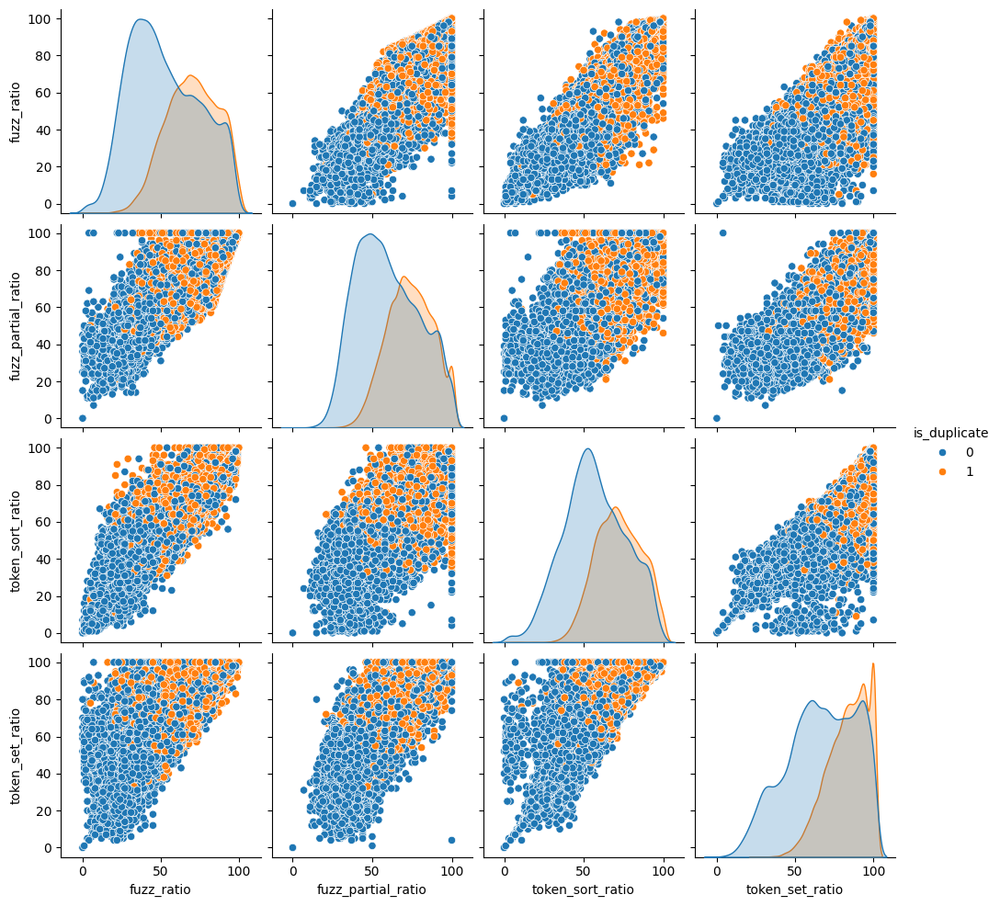

In [54]:
sns.pairplot(new_df[['fuzz_ratio', 'fuzz_partial_ratio','token_sort_ratio','token_set_ratio', 'is_duplicate']],hue='is_duplicate')

In [55]:
# Using TSNE for Dimentionality reduction for 15 Features(Generated after cleaning the data) to 3 dimention

from sklearn.preprocessing import MinMaxScaler

X = MinMaxScaler().fit_transform(new_df[['cwc_min', 'cwc_max', 'csc_min', 'csc_max' , 'ctc_min' , 'ctc_max' , 'last_word_eq', 'first_word_eq' , 'abs_len_diff' , 'mean_len' , 'token_set_ratio' , 'token_sort_ratio' ,  'fuzz_ratio' , 'fuzz_partial_ratio' , 'longest_substr_ratio']])
y = new_df['is_duplicate'].values

In [56]:
print(X)

[[0.87499287 0.87499287 0.99998588 ... 0.99       0.99       0.89041031]
 [0.66664734 0.49998967 0.71427971 ... 0.69       0.66       0.23404221]
 [0.         0.         0.42856783 ... 0.26       0.3        0.04901959]
 ...
 [0.66664734 0.66664734 0.99995588 ... 0.85       0.92       0.8333304 ]
 [0.59999061 0.42856717 0.79998871 ... 0.43       0.62       0.38297815]
 [0.66664734 0.49998967 0.39999435 ... 0.6        0.66       0.42105179]]


In [69]:
from sklearn.manifold import TSNE

tsne2d = TSNE(
    n_components=2,       # Reduces data to 2 dimensions
    init='random',        # Initialization method (alternative is 'pca')
    random_state=101,     # Sets a seed for reproducibility
    method='barnes_hut',  # Optimization method for faster t-SNE on larger datasets
    n_iter=1000,          # Maximum number of iterations for optimization
    verbose=2,            # Displays progress and diagnostic information
    angle=0.5             # Balances speed and accuracy in Barnes-Hut approximation
).fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 50000 samples in 0.128s...
[t-SNE] Computed neighbors for 50000 samples in 11.926s...
[t-SNE] Computed conditional probabilities for sample 1000 / 50000
[t-SNE] Computed conditional probabilities for sample 2000 / 50000
[t-SNE] Computed conditional probabilities for sample 3000 / 50000
[t-SNE] Computed conditional probabilities for sample 4000 / 50000
[t-SNE] Computed conditional probabilities for sample 5000 / 50000
[t-SNE] Computed conditional probabilities for sample 6000 / 50000
[t-SNE] Computed conditional probabilities for sample 7000 / 50000
[t-SNE] Computed conditional probabilities for sample 8000 / 50000
[t-SNE] Computed conditional probabilities for sample 9000 / 50000
[t-SNE] Computed conditional probabilities for sample 10000 / 50000
[t-SNE] Computed conditional probabilities for sample 11000 / 50000
[t-SNE] Computed conditional probabilities for sample 12000 / 50000
[t-SNE] Computed conditional probabilities for sa

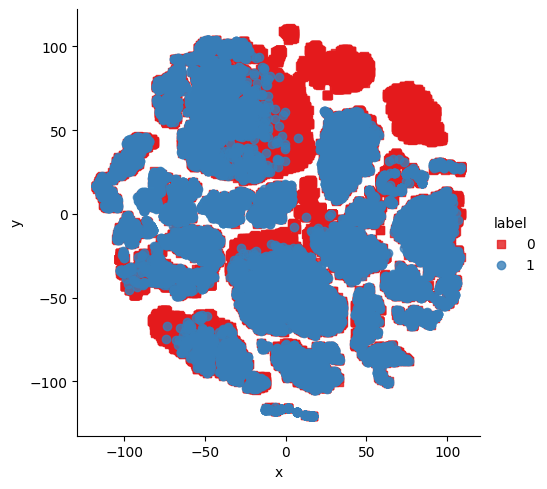

In [70]:
x_df = pd.DataFrame({'x':tsne2d[:,0], 'y':tsne2d[:,1] ,'label':y})

# draw the plot in appropriate place in the grid
sns.lmplot(data=x_df, x='x', y='y', hue='label', fit_reg=False,palette="Set1",markers=['s','o'])

In [71]:
#which features we take it after applay the above algo?
print(tsne2d[:,0]) #return the values not the name of this feature


[-97.10484   39.697365  24.558376 ...  54.278576   6.507683 -21.511335]


In [72]:
tsne3d = TSNE(
    n_components=3,       # Reduces data to 3 dimensions
    init='random',        # Initializes embedding positions randomly
    random_state=101,     # Ensures reproducibility
    method='barnes_hut',  # Efficient method for large datasets
    n_iter=1000,          # Maximum number of optimization iterations
    verbose=2,            # Displays progress logs during training
    angle=0.5             # Balances speed and accuracy of the approximation
).fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 50000 samples in 0.122s...
[t-SNE] Computed neighbors for 50000 samples in 14.382s...
[t-SNE] Computed conditional probabilities for sample 1000 / 50000
[t-SNE] Computed conditional probabilities for sample 2000 / 50000
[t-SNE] Computed conditional probabilities for sample 3000 / 50000
[t-SNE] Computed conditional probabilities for sample 4000 / 50000
[t-SNE] Computed conditional probabilities for sample 5000 / 50000
[t-SNE] Computed conditional probabilities for sample 6000 / 50000
[t-SNE] Computed conditional probabilities for sample 7000 / 50000
[t-SNE] Computed conditional probabilities for sample 8000 / 50000
[t-SNE] Computed conditional probabilities for sample 9000 / 50000
[t-SNE] Computed conditional probabilities for sample 10000 / 50000
[t-SNE] Computed conditional probabilities for sample 11000 / 50000
[t-SNE] Computed conditional probabilities for sample 12000 / 50000
[t-SNE] Computed conditional probabilities for sa

In [73]:
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.offline as py
py.init_notebook_mode(connected=True)

trace1 = go.Scatter3d(
    x=tsne3d[:,0],
    y=tsne3d[:,1],
    z=tsne3d[:,2],
    mode='markers',
    marker=dict(
        sizemode='diameter',
        color = y,
        colorscale = 'Portland',
        colorbar = dict(title = 'duplicate'),
        line=dict(color='rgb(255, 255, 255)'),
        opacity=0.75
    )
)

data=[trace1]
layout=dict(height=800, width=800, title='3d embedding with engineered features')
fig=dict(data=data, layout=layout)
py.iplot(fig, filename='3DBubble')

# step5: BOW after extract new features

In [59]:
ques_df = new_df[['question1','question2']]
ques_df.head()

,question1,question2
398782,what is the best marketing automation tool for...,what is the best marketing automation tool for...
115086,i am poor but i want to invest what should i do,i am quite poor and i want to be very rich wha...
327711,i am from india and live abroad i met a guy fr...,t i e t to thapar university to thapar univers...
367788,why do so many people in the u s hate the sout...,my boyfriend doesnt feel guilty when he hurt m...
151235,consequence of bhopal gas tragedy,what wa the reason behind the bhopal gas tragedy


In [60]:
final_df = new_df.drop(columns=['id','qid1','qid2','question1','question2'])
print(final_df.shape)
final_df.head()

(50000, 23)


,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,word_common,word_total,word_share,cwc_min,cwc_max,...,ctc_max,last_word_eq,first_word_eq,abs_len_diff,mean_len,longest_substr_ratio,fuzz_ratio,fuzz_partial_ratio,token_sort_ratio,token_set_ratio
398782,1,73,74,13,13,12,26,0.46,0.874989,0.874989,...,0.923070,1.0,1.0,0.0,13.0,0.890410,99,99,99,99
115086,0,47,55,12,15,7,22,0.32,0.666644,0.499988,...,0.466664,1.0,1.0,3.0,13.5,0.234042,69,66,65,74
327711,0,102,118,26,20,3,36,0.08,0.000000,0.000000,...,0.115384,0.0,0.0,6.0,23.0,0.049020,26,30,34,43
367788,0,56,140,13,30,0,32,0.00,0.000000,0.000000,...,0.000000,0.0,0.0,17.0,21.5,0.053571,26,45,26,30
151235,0,33,48,5,9,3,13,0.23,0.749981,0.499992,...,0.333330,1.0,0.0,4.0,7.0,0.575756,57,71,49,71


In [61]:
from sklearn.feature_extraction.text import CountVectorizer
# merge texts
questions = list(ques_df['question1']) + list(ques_df['question2'])

cv = CountVectorizer(max_features=10000)
q1_arr, q2_arr = np.vsplit(cv.fit_transform(questions).astype('int8').toarray(),2)

In [62]:
temp_df1 = pd.DataFrame(q1_arr, index= ques_df.index)
temp_df2 = pd.DataFrame(q2_arr, index= ques_df.index)
temp_df = pd.concat([temp_df1, temp_df2], axis=1)
temp_df.shape

(50000, 20000)

In [63]:
temp_df.head()

,0,1,2,3,4,5,6,7,8,9,...,9990,9991,9992,9993,9994,9995,9996,9997,9998,9999
398782,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
115086,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
327711,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
367788,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
151235,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [64]:
final_df = pd.concat([final_df, temp_df], axis=1)
print(final_df.shape)
final_df.head()

(50000, 20023)


,is_duplicate,q1_len,q2_len,q1_num_words,q2_num_words,word_common,word_total,word_share,cwc_min,cwc_max,...,9990,9991,9992,9993,9994,9995,9996,9997,9998,9999
398782,1,73,74,13,13,12,26,0.46,0.874989,0.874989,...,0,0,0,0,0,0,0,0,0,0
115086,0,47,55,12,15,7,22,0.32,0.666644,0.499988,...,0,0,0,0,0,0,0,0,0,0
327711,0,102,118,26,20,3,36,0.08,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
367788,0,56,140,13,30,0,32,0.00,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
151235,0,33,48,5,9,3,13,0.23,0.749981,0.499992,...,0,0,0,0,0,0,0,0,0,0


# step6: Model training

In [65]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(final_df.iloc[:,1:].values,final_df.iloc[:,0].values,test_size=0.2,random_state=1)

In [66]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred_lr = lr.predict(X_test)
accuracy_score(y_test, y_pred_lr)

0.7346

In [67]:
from xgboost import XGBClassifier
xgb = XGBClassifier()
xgb.fit(X_train,y_train)
y_pred = xgb.predict(X_test)
accuracy_score(y_test,y_pred)

0.7966

In [68]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
rf = RandomForestClassifier()
rf.fit(X_train,y_train)
y_pred = rf.predict(X_test)
accuracy_score(y_test,y_pred)

0.7942